# Meeting 10/27/17

## VNECT 3D

### Disadvantages:

* no multi person
* very unstable in consequtive frames
* weird bounding boxes

### Time:

* 2.8908 for 30 Simmons frames
* 1.3840 for 30 pitcher frames
* 1.3378 for 30 pitcher frames
* 1.2290 for 60 pitcher frames
* 1.2952 for 90 pitcher frames

## BATTER FIRST MOVE:

### sequence alignment:

* align sequences with dtak --> take shift of one labeled sequences found by alignment
* problem: all depended on this one sequence for comparison
* solution: take mean of output of several sequences

Variations:
* seperately for each joint (more computational effort)
* for all joints but only trajectory in x direction
* for all joints (including y direction)
* only take closest value to the moment of label:
    * calculate all distances of s2 from labeled point of s1
    * take closest k points and take mean of them
    * but still unstable
* simple shift:
    * shift whole sequence by one frame and find the one in which labeled point is closest


### normalize and take zero point

* in the beginning the normalized x trajectory is >0, then it decreases rapidly
* but: unstable

### Neural Network

Methods:
* problem: no labeled data
* solution: label a part of them (60) by using the gradient cut off method
* then shift them and stretch the normalized tajectories in order to generate more data artificially

Variations of networks:
* 167 bins
* use release frame --> 50 bins after release frame
* use release frame and use one scalar as continous output instead of descrete classes for the frame number

--> Problem: no way to measure accuracy because no labels! test on manually labeled new data of 17 examples:

accuracy examples (frames away of real first move frame, first nr is the average):
* without release: 3.5625 [ 0  5  6  5 13  6  0  0  5  6  6  0  1  0  2  2]
* with release and bins: 5.0625 [ 1  7  8  5 10  4  6  3  7  2  2  0  2  0  6 18]
* with release and scalar output: 3.125 [5 0 5 1 4 2 1 5 6 1 3 2 2 5 5 3]

## SEQUENCE CLUSTERING

Idea: using similarity of time series and alignment methods is not only useful for the first movement prediction, but might also be a way to classify the pitch type and perform other tasks

Main problem: sequences are not aligned

### Methods:
* K means clustering
* Which distance measure?
    * DTAK distance
    * Pearson coefficient for defining similariy of two sequences --> calculate coefficient for each sequence seperately and take mean

### Results:
* almost 100% accuracy with all different methods on distinguishing running batter from pitcher trajectories
* very bad results on classifying run, hit and nothing task (just chance) but might be a problem of very noisy data (even if nothing happens, no swing and no run, the batter often moves around or walks away after the play)


## PCA (DIMENSION REDUCTION):

Idea: high dimensional data (arrays of ?*167*12*2) could be reduced to the principal components the explain most of the variation

Main Problem:
* along which axis?
* not linear

Method used:
* resize array to size (?*167, 12*2) = (?*167, 24), meaning that we look at each image (frame) seperately and view all joint coordinates in this image as one point in a 24 dimensional space
* then find 5 principal components of all this data
* project data onto the principal components --> yields (?*167, 5) array --> reduced dimension of joint coordinates
* resize array back to get trajectory in reduced space
* perform clustering/ neural network classification on this data of reduced dimension

Results:
* no improvement in run hit no run sequence alignment
* no improvement in neural network for pitch type classification


## BIDIRETCIONAL LSTM

New idea: for pitch type classification or other sequence related task, use bidiretcional LSTM

--> takes whole context (also frames afterwards) into account

so far only 40% accuracy


# Ideas to work on:

* mean trajectory for each pitch type - then take these as cluster centers and test directly
* baseball bat detection


In [5]:
import cv2
import numpy as np
import matplotlib
import matplotlib.pylab as plt
import json
import pandas as pd
from skvideo import io #.io import VideoWriter
import skvideo

In [ ]:
with open("/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/center_dics.json", "r") as infile:
    dic = json.load(infile)

print(dic)
    
file = "#31 LHP Michael Chavez (2)"
f = "/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/pitcher/"+file+".mp4" # 300:1000, 400:1100
#
video_capture = cv2.VideoCapture(f)

a,b = dic[file] #(1350, 550)
center = a,b
print(center)

#dic[file] = center

p = 0
while p<1:
    ret, frame = video_capture.read()
    if frame is None:
        break
    #canvas = frame #[top_b:bottom_b, left_b:right_b] # cv2.imread(f) # B,G,R order
    #oriImg = canvas.copy()
     #[top_b:bottom_b, left_b:right_b])
    cv2.circle(frame, tuple(center) , 20, [255,0,0], thickness=-1)
    plt.imshow(frame)
    plt.show()
    p+=1

In [302]:
def color_video(json_array, vid_file, start = 0, end = 300, printing =None):
    colors = [[255, 0, 0], [0, 255, 0], [0, 0, 255], [255, 255, 0], [255, 0, 255], [0, 255, 255], [0, 170, 255],
              [0, 0, 0], \
          [255, 0, 85], [0, 255, 170],  [0, 170, 255], [0, 85, 255],  [85, 0, 255], \
          [170, 0, 255], [255, 0, 170], [255, 0, 85]]
    colors_string = ["blue", "green", "red", "tuerkis", "pink", "yellow", "orange", "black", "purple"]
    nr_joints =12
    #print(json_array.shape)
    #writer = cv2.VideoWriter("/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/outputs_example/test.avi",cv2.VideoWriter_fourcc(*"XVID") , 20, (500,800))

    #writer = io.FFmpegWriter("/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/outputs_example/test.avi", (10,800,500,3))
    #writer.open()
    video_capture = cv2.VideoCapture(vid_file)
    video_capture.set(cv2.CAP_PROP_POS_FRAMES, start)
    arr = [] #np.zeros((100,800,500,3))


    for k in range(start, end):
        if printing!=None:
            #print("dist_min",  "ratio_min")
            #print(colors_string[printing[k][0]], colors_string[printing[k][1]])
            print(printing[k])
        ret, frame = video_capture.read()
        if frame is None:
            break
        if len(json_array[k].shape)==2:
            all_peaks = np.reshape(json_array[k], (12, 1,2))
        else:
            all_peaks = json_array[k]
        canvas = frame #[top_b:bottom_b, left_b:right_b] # cv2.imread(f) # B,G,R order
        oriImg = canvas.copy()
        for i in range(len(all_peaks)):
            for j in range(len(all_peaks[i])):
                cv2.circle(canvas, (int(all_peaks[i,j,1]),int(all_peaks[i,j,0])) , 8, colors[i], thickness=-1)

        to_plot = cv2.addWeighted(oriImg, 0.3, canvas, 0.7, 0)
        plt.imshow(to_plot[:,:,[2,1,0]])
        fig = matplotlib.pyplot.gcf()
        fig.set_size_inches(12, 12)
        arr.append(to_plot[:,:,[2,1,0]])
        # image = np.fromstring(canvas.tostring_rgb(), dtype='uint8')
        #print(to_plot.astype('uint8').shape)
        #writer.write(to_plot[:,:,[2,1,0]].astype('uint8'))
        # plt.savefig("/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/outputs_example/%3d"%k)
        plt.show()
    #writer.release()
    arr = np.array(arr)
    return arr

def from_json(file):
    coordinates = ["x", "y"]
    joints_list = ["right_shoulder", "left_shoulder", "right_elbow", "right_wrist","left_elbow", "left_wrist",
            "right_hip", "right_knee", "right_ankle", "left_hip", "left_knee", "left_ankle", "neck ",
            "right_eye", "right_ear","left_eye", "left_ear"]
    with open(file, 'r') as inf:
        out = json.load(inf)

    liste = []
    for fr in out["frames"]:
        l_joints = []
        for j in joints_list[:12]:
            l_coo = []
            for xy in coordinates:
                l_coo.append(fr[j][xy])
            l_joints.append(l_coo)
        liste.append(l_joints)
    return np.array(liste)

In [ ]:
# SAVE EXAMPLE TO FOLDER:
# f = "/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/test_image.jpg"


from os import listdir
dire = listdir("/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/outputs_example/")
for fi in dire:
    filename = fi.split("_")[0] #"#33 Logan Trowbridge"
    print(filename)
    if filename[-4:]==".mp4": #or filename+".mp4" in dire:
        print("already there")
        continue
    if filename+".mp4" in listdir("/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/batter"):
        player = "batter/"
    else:
        player = "pitcher/"


    colors = [[255, 0, 0], [255, 85, 0], [255, 170, 0], [255, 255, 0], [170, 255, 0], [85, 255, 0], [0, 255, 0], \
              [0, 0, 0], [0, 255, 170], [0, 255, 255], [0, 170, 255], [0, 85, 255], [0, 0, 255], [85, 0, 255], \
              [170, 0, 255], [255, 0, 255], [255, 0, 170], [255, 0, 85]]


    cmap = matplotlib.cm.get_cmap('hsv')

    vid_file = "/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/"+player+filename+".mp4"
    json_array = from_json("/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/outputs_example/"+filename+"_joints.json")
    # = np.swapaxes(np.load("/Users/ninawiedemann/Desktop/UNI/Praktikum/handle_one_bsp.npy"), 0,1)
    nr_joints = 12
    print(json_array.shape)
    
    
    arr = color_video(json_array, vid_file)
    skvideo.io.vwrite("/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/outputs_example/"+filename+".mp4", arr)

In [ ]:
video_capture = cv2.VideoCapture("/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/outputs_example/outputvideo.mp4")

while True:
    ret, frame = video_capture.read()
    if frame is None:
        break
    plt.imshow(frame)
    plt.show()

In [94]:
df = pd.read_csv("/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/handle_one.csv", dtype = {"Frame": np.int32, "Batter": np.ndarray})

In [103]:
f = "/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/batter/#11 Mark Mathias (2).mp4"
    
df_coord = from_json("/Users/ninawiedemann/Desktop/UNI/Praktikum/high_quality_testing/bsp_new_func.json")
print(df_coord.shape)

def str_to_arr(string):
    new_str = string.replace('\n', ',').replace('[  ', '[').replace(' ]', ']').replace("  ", ",").replace(",,",",").replace(",,",",").replace("[,", "[")
    return np.array(eval(new_str))

handle_one_arr = []
for i in range(len(df.values)):
    handle_one_arr.append(str_to_arr(df["Batter"][i]))
print(len(handle_one_arr))

(554, 12, 2)
554


[139.56716324248893, 331.24502944383937, 211.38380562675562, 214.57734619479288, 30.666426063367737, 265.84615058572882, 31.128200136692772, inf]


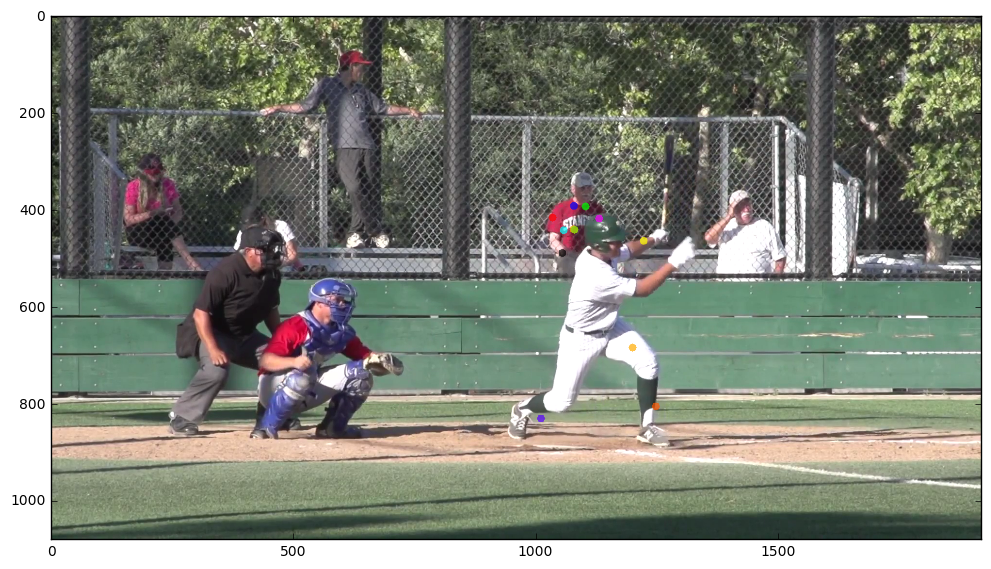

[138.67027238901798, 328.37282902784449, 204.78985990216898, 216.30579121350402, 0.25, 265.88127343327511, 41.60998227589144, inf]


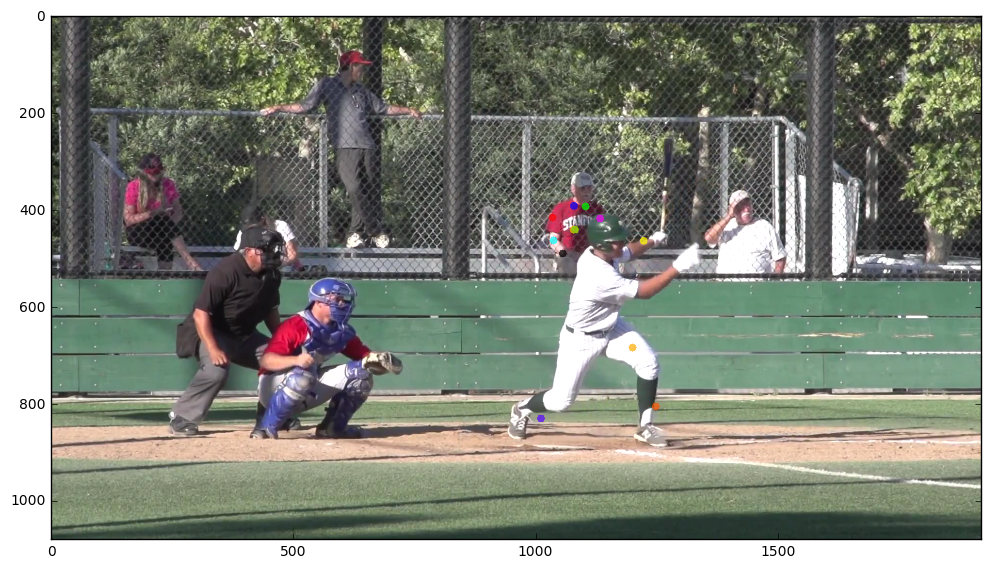

[138.91396718032993, 216.36087295014781, 328.47577678955264, 204.79754675349508, 265.80305796773672, 0.19764235376052372, 40.901988414379076, inf]


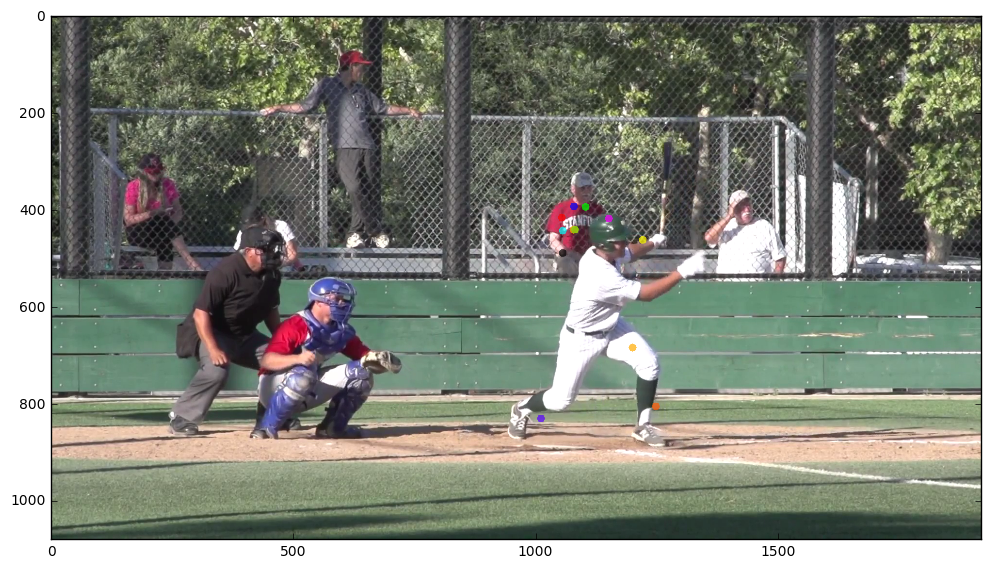

[216.4421653409982, 139.00984177787956, 328.55314329458179, 204.89631524261242, 265.82959032761948, 5.1693961204380541, 41.68173685800533]


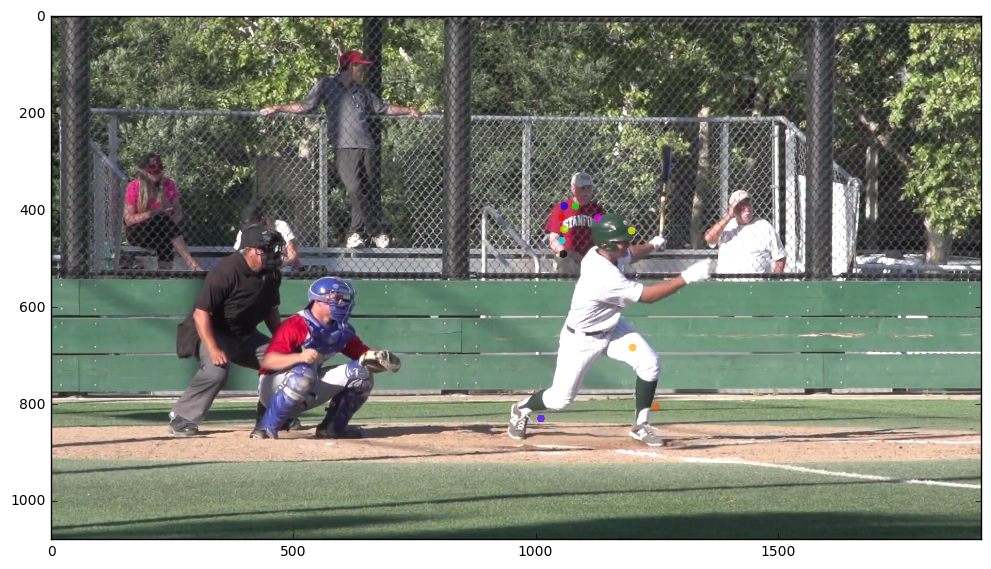

[213.13061759458682, 324.8848654235066, 144.80707951539446, 201.84362178738766, 260.26079918756494, 45.06219660092038, 30.002669152093784]


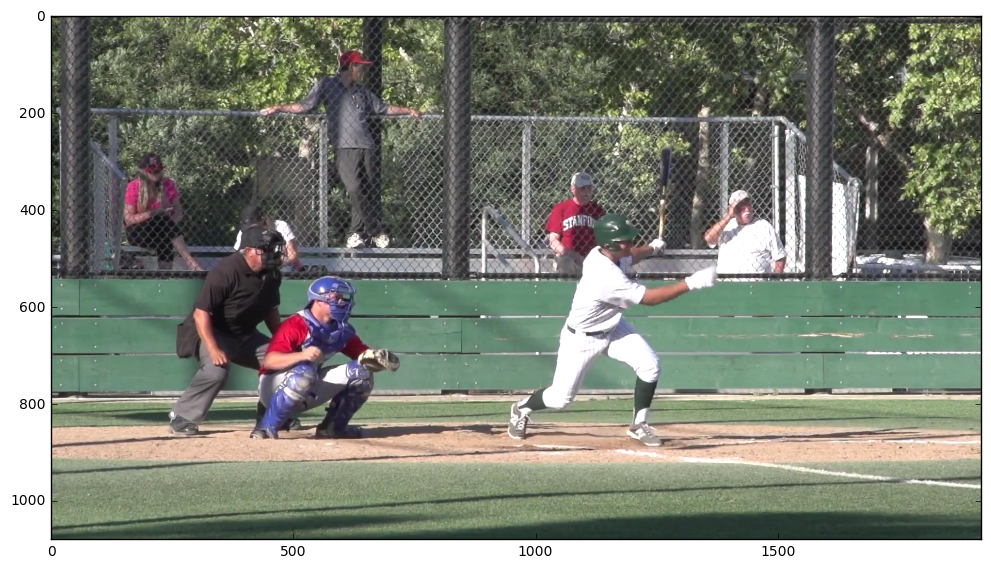

[213.07222587071269, 325.02793750114773, 149.47386895374055, 201.85419784463241, 260.15009189408335, 30.032534441834908, 48.663986619984186]


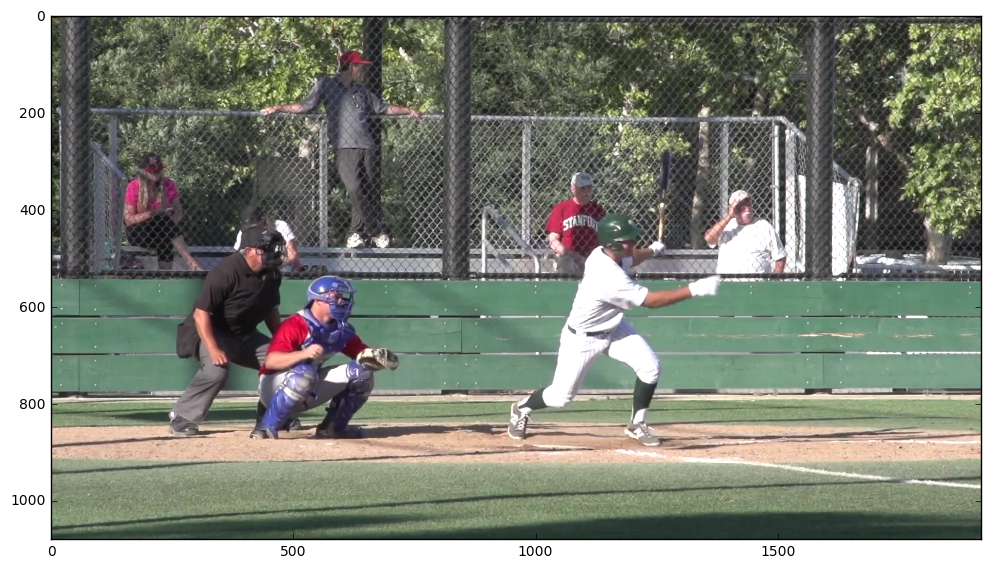

[324.9154938210857, 213.07883480944324, 201.86752114629536, 166.65860313827187, 30.727252765257099, 260.10420838339007, 49.036537716788281]


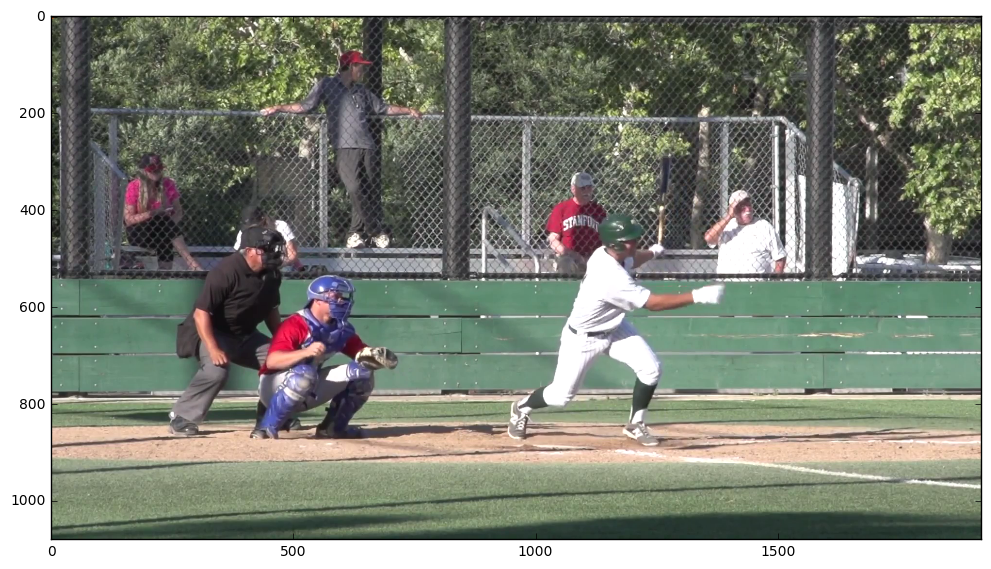

[324.97725881975185, 213.00394289190987, 201.86752114629536, 166.26169131823482, 30.799058934486943, 260.11315146009053, 45.356659516547289]


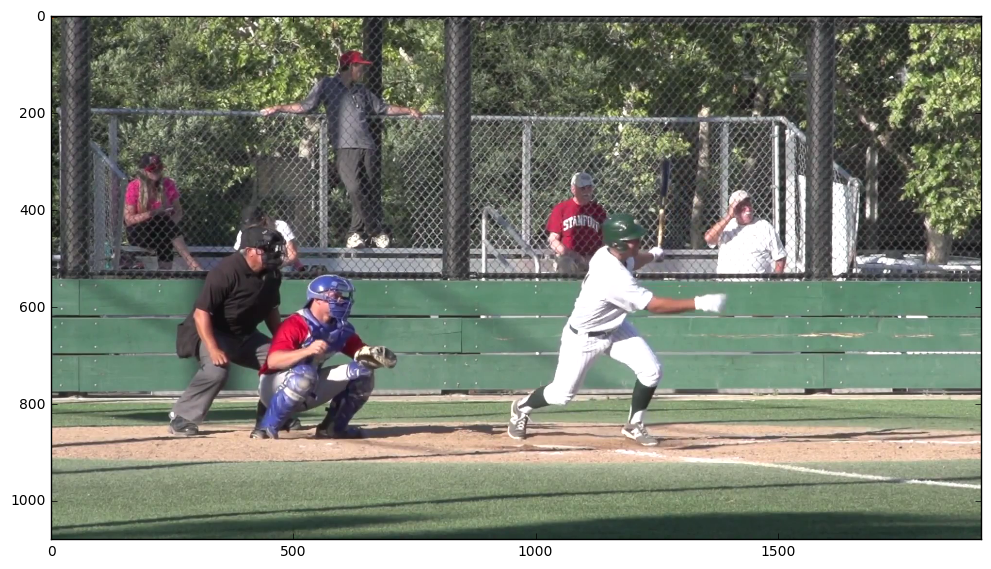

[212.98478708877309, 324.98358732596023, 144.1309686053317, 201.86752114629536, 7.5394794250001107, 52.221857961772976, 261.32742572776397]


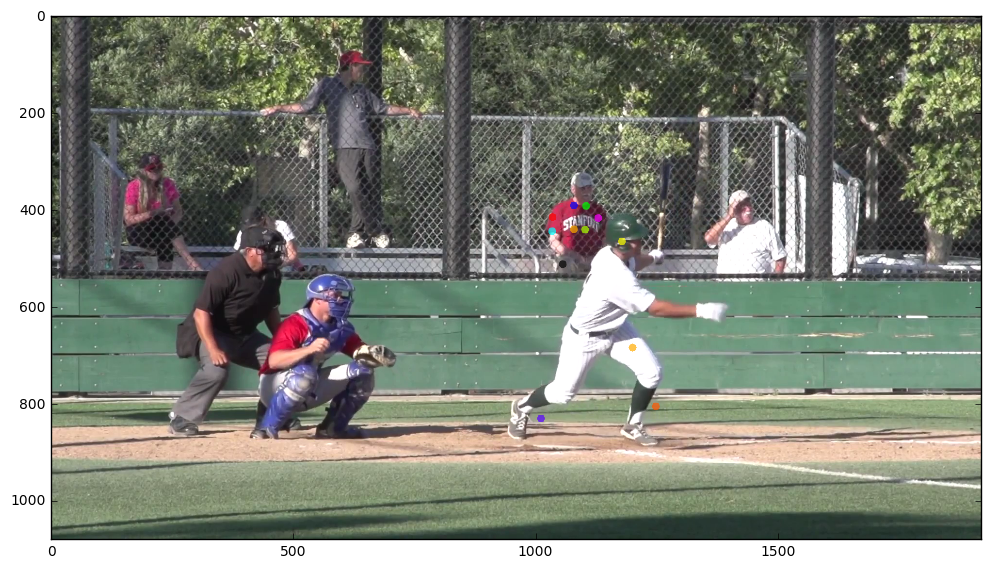

[217.01174543385895, 329.6232994362656, 206.02644134006198, 137.15494583377833, 27.140692465373835, 264.33836182296733, 42.642408468565655]


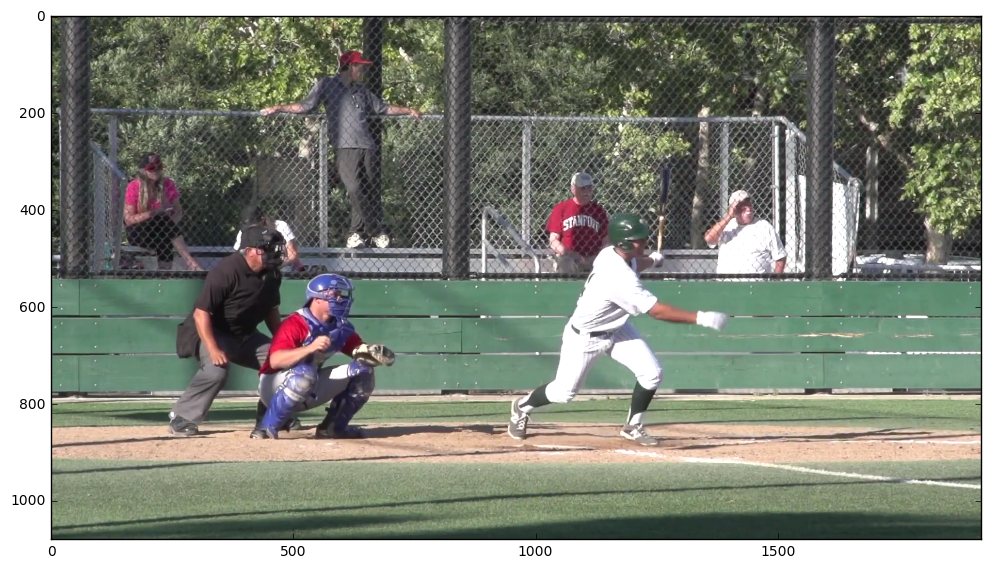

[216.89220933161707, 329.47497296835763, 205.98493383922525, 176.83104577533891, 27.143067139695177, 264.18639844814118, 43.041313728788531]


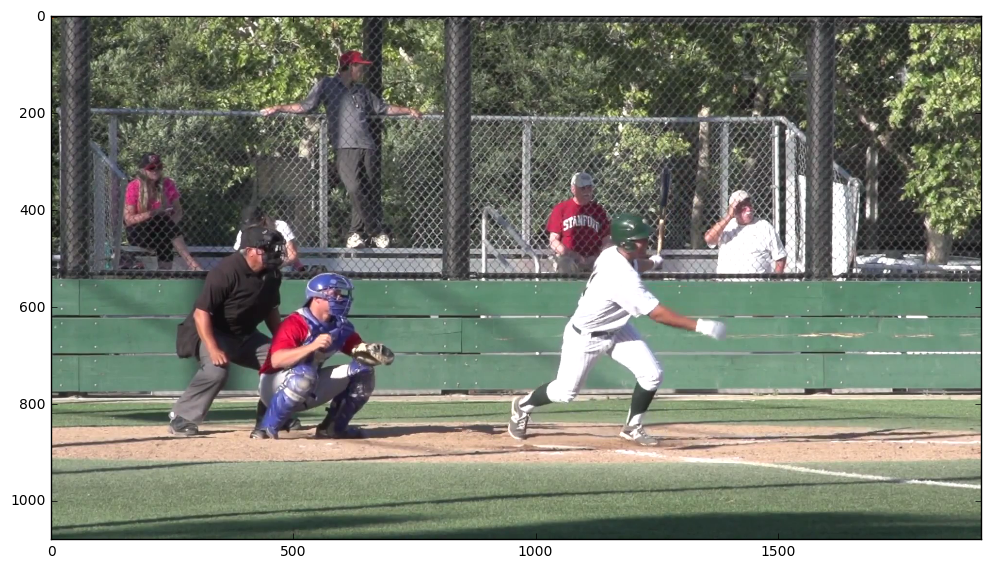

[216.89169604320955, 327.96430588937574, 205.96326659746879, 176.68426111286766, 27.078949965794465, 264.21556214812557, 42.277219412468462, inf]


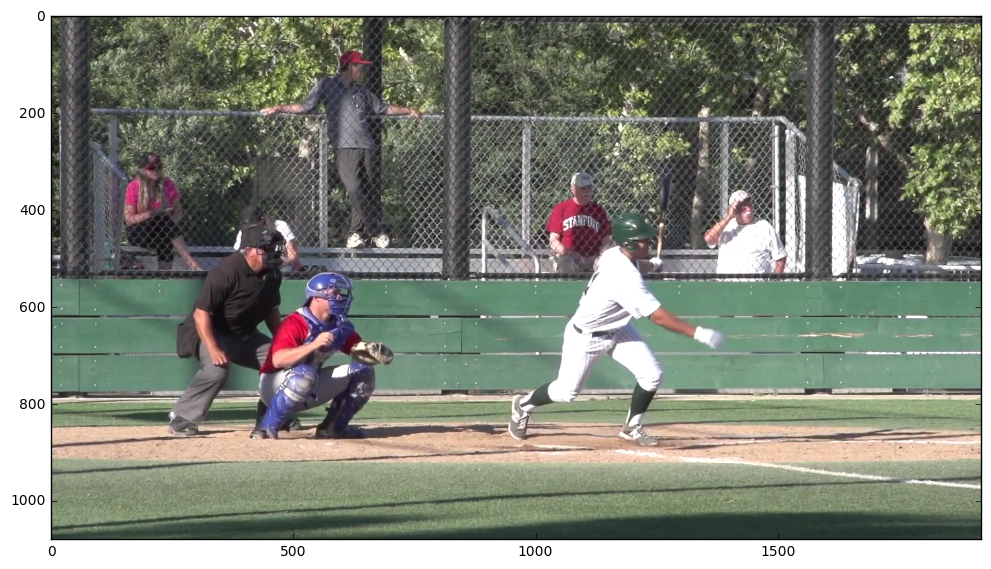

[216.89001208850075, 327.95810041070797, 205.92432620989683, 176.59987436292246, 27.045967814075354, 264.15300224254503, 46.729189887050254]


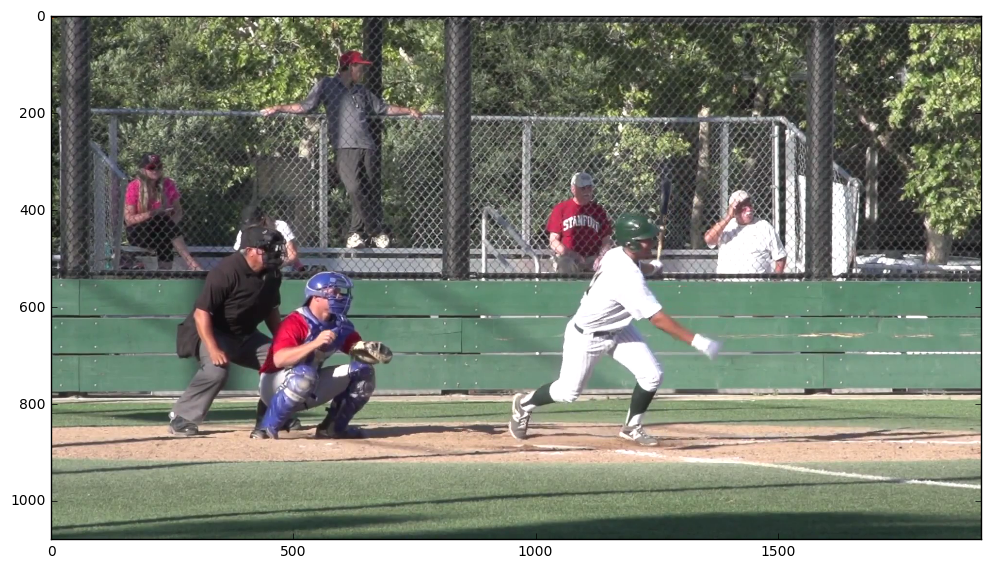

[216.92558848024362, 329.63212212631828, 205.92789241625331, 156.95814728774036, 26.949243379916997, 264.03931111200092, 47.140580978600596, inf]


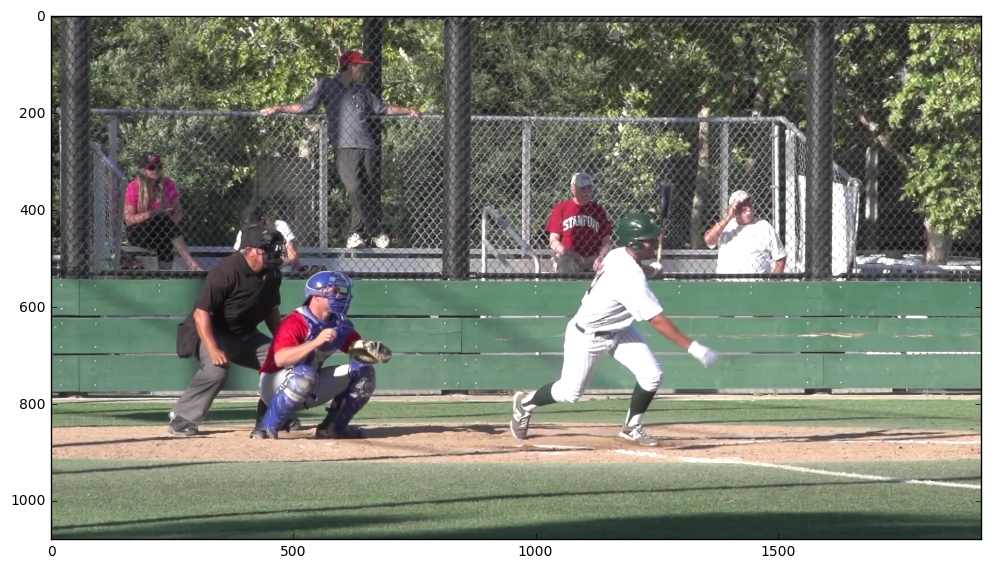

[216.88800393290543, 330.83165800373456, 206.00060679522281, 137.06418305953522, 41.859185446565967, 48.860771586212188, 264.03792045367271, 482.52299168018925]


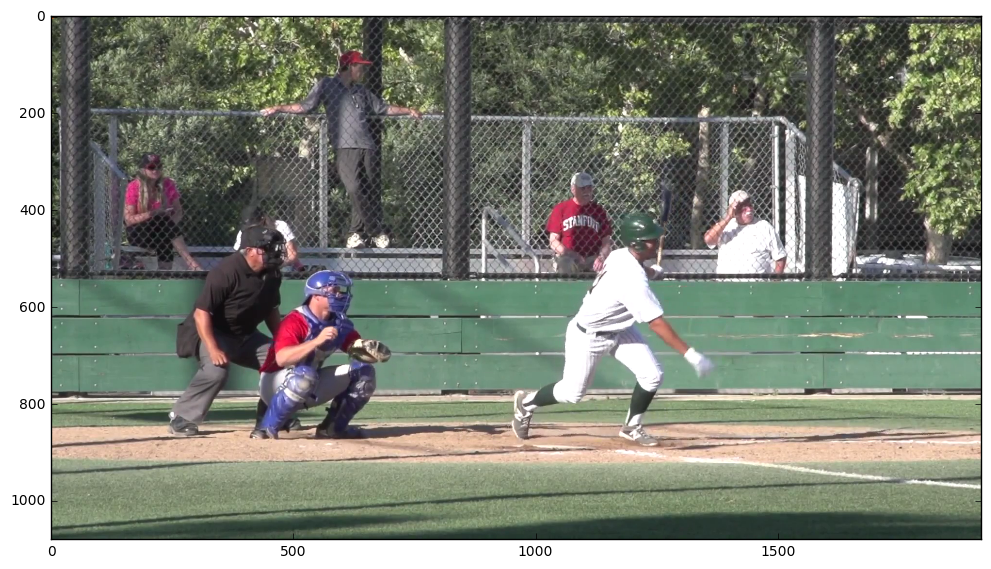

[327.91317567497953, 216.96919784268917, 156.33985416393352, 206.03933369929635, 41.713915918431823, 264.081515587517, 50.382792511431916]


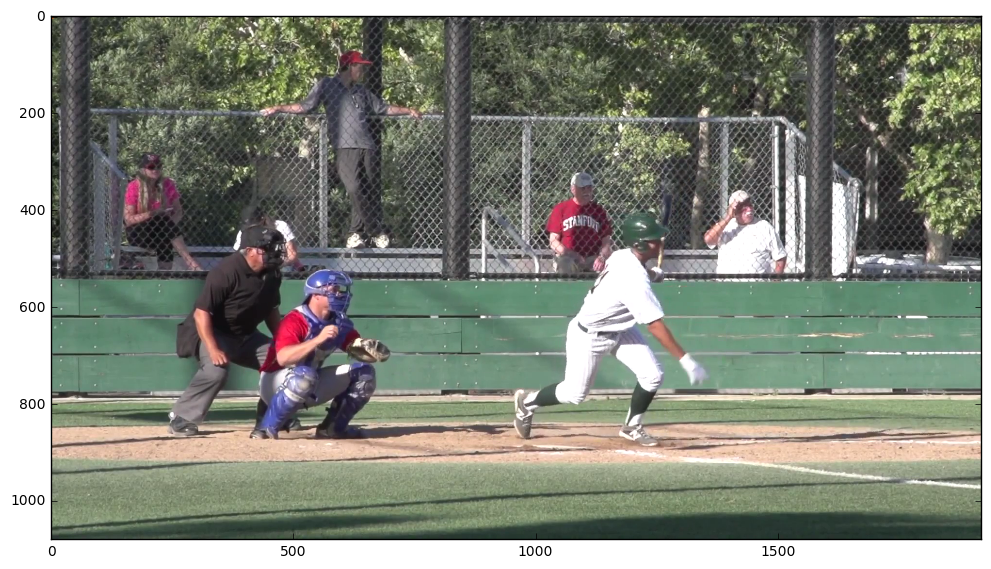

[331.03313655886473, 216.8529077364424, 206.01521674684616, 155.33418812354222, 56.316731250579522, 264.02342906217621, 51.068849054487217]


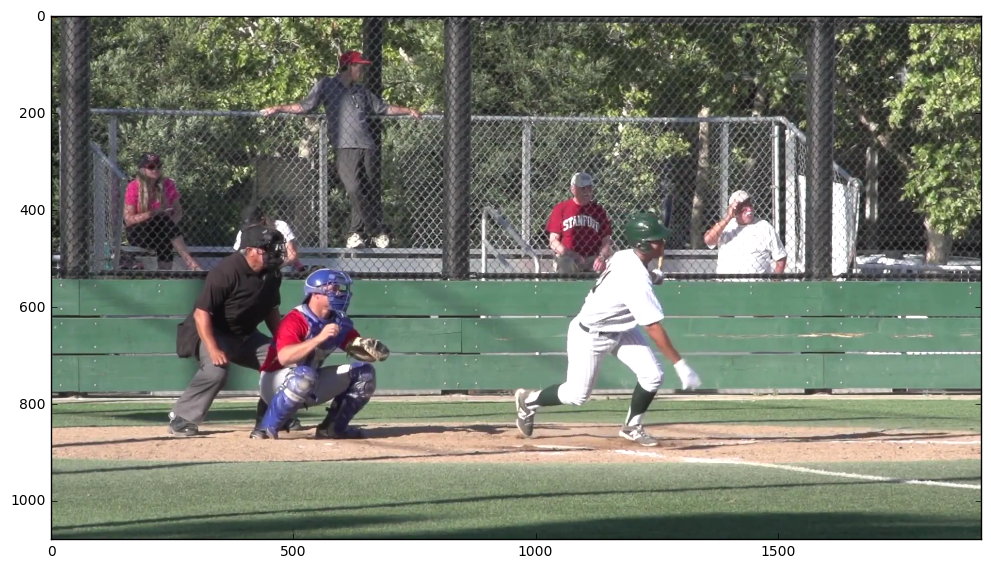

[327.91179382762374, 216.93998486044475, 155.00096773891445, 205.9778791976216, 56.251840247675453, 264.01651966543682, 49.586178139679205]


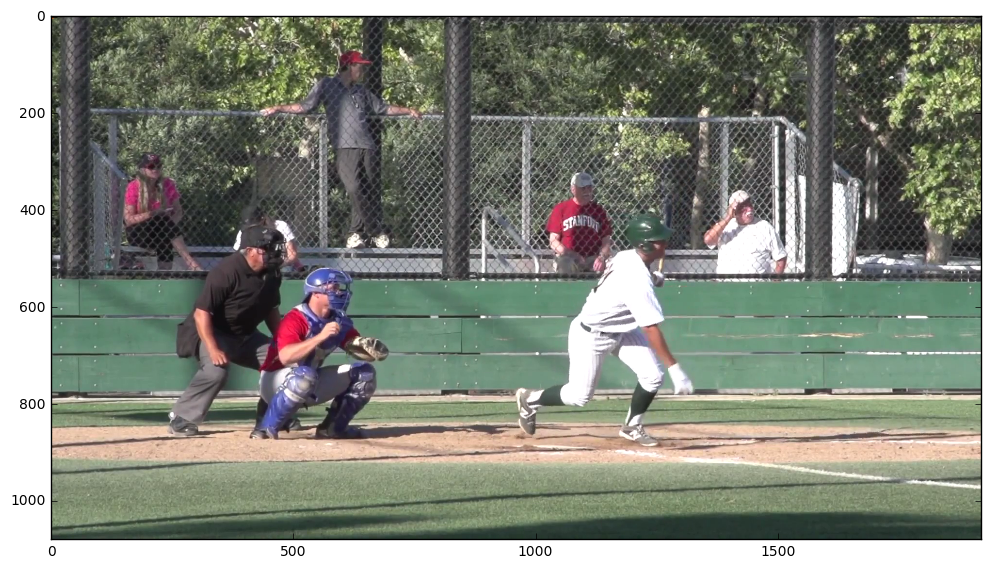

[329.40500930655259, 216.89292973435073, 174.09543000894652, 205.94250752637251, 56.668684859894178, 264.04574650995613, 45.723737339045243]


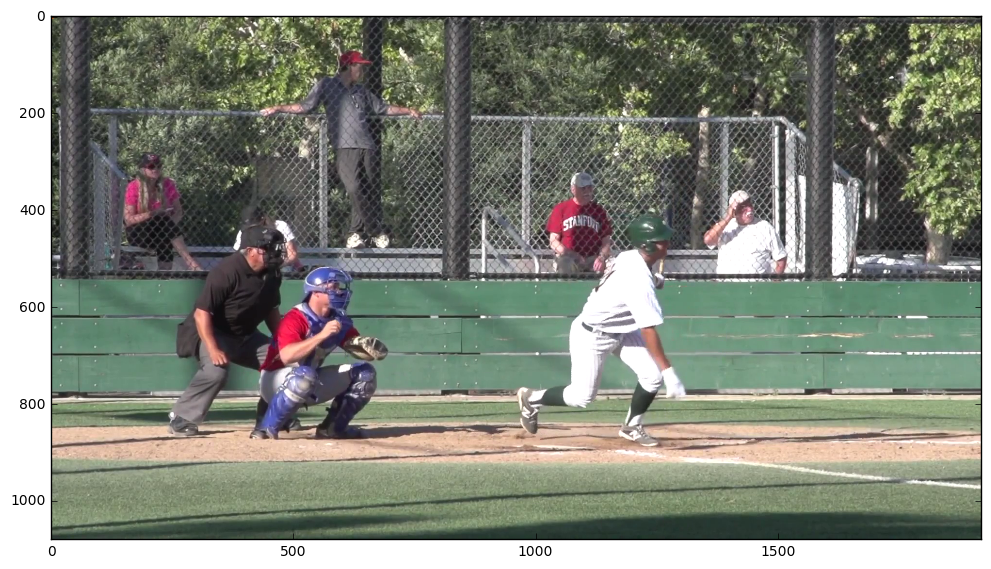

[327.781802661847, 216.91007461330605, 174.11934664189388, 205.96308642266459, 55.007669919748466, 264.05063582814944, 49.970538195020474, inf]


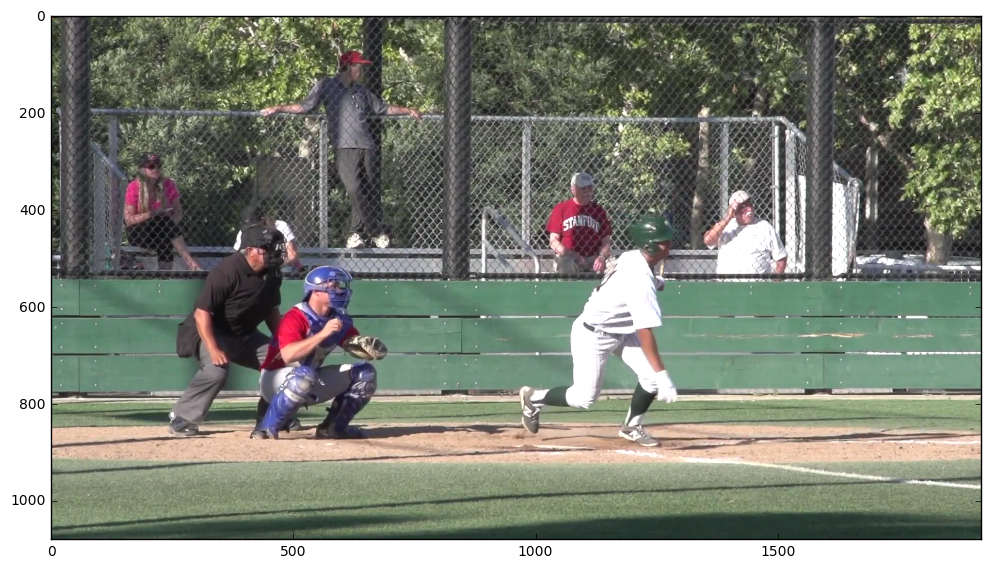

In [322]:
#arr = color_video(handle_one_arr, f, start = 255, end = 280, printing = argmin_list)
arr2 = color_video(new_df[:,:12,:], f, start = 260, end = 280, printing = argmin_list)

In [318]:
player_list = [0]
df_handle = [handle_one_arr, handle_one_arr.copy()]
limb_list=['shoulder','elbow','wrist','hip','knee','ankle','Neck','eye','ear']
# player_list=['Pitcher']
col_pitcher=['Pitcher_Right_shoulder','Pitcher_Left_shoulder','Pitcher_Right_elbow','Pitcher_Right_wrist','Pitcher_Left_elbow','Pitcher_Left_wrist','Pitcher_Right_hip','Pitcher_Right_knee','Pitcher_Right_ankle','Pitcher_Left_hip','Pitcher_Left_knee','Pitcher_Left_ankle','Pitcher_Neck','Pitcher_Right_eye','Pitcher_Right_ear','Pitcher_Left_eye','Pitcher_Left_ear']
col_batter=['Batter_Right_shoulder','Batter_Left_shoulder','Batter_200Right_elbow','Batter_Right_wrist','Batter_Left_elbow','Batter_Left_wrist','Batter_Right_hip','Batter_Right_knee','Batter_Right_ankle','Batter_Left_hip','Batter_Left_knee','Batter_Left_ankle','Batter_Neck','Batter_Right_eye','Batter_Right_ear','Batter_Left_eye','Batter_Left_ear']

from scipy.spatial.distance import cdist

joints_for_cdist = np.arange(0,18,1)
important_joints = [0,1,6,7,8,9,10,11]

argmin_list = []

def player_localization(df,frame,player,old_array, body_dist):
    #player2=player+'_player'
    dist=[]
    ratios = []
    for i in range(np.asarray(df[player][frame]).shape[0]):
        zerrow1=np.where(np.asarray(df[player][frame])[i,:,0]!=0)[0]
        zerrow2=np.where(old_array[:,0]!=0)[0]
        zerrow_all =np.intersect1d(zerrow1,zerrow2) # assume unique argument for speedup?
        zerrow = np.intersect1d(zerrow_all, important_joints)
        # print("leng", len(zerrow), zerrow)

        if len(zerrow)<2:
            dist.append(np.inf)
            ratios.append(np.inf)
            continue
        
        dist.append(np.linalg.norm(np.asarray(df[player][frame])[i,zerrow,:] - old_array[zerrow])/len(zerrow))

        p = df[player][frame][i]
        player_dist = cdist(p,p)
        
        def cut_nonzero(cdi, nonzero):
            cdi = (cdi[nonzero])
            cdi = np.swapaxes(cdi,0,1)
            cdi = cdi[nonzero]
            cdi = np.swapaxes(cdi,0,1)
            return cdi

        ratios.append(np.linalg.norm(cut_nonzero(body_dist, zerrow) - cut_nonzero(player_dist, zerrow)))
    
   
    #print df[player][frame]
    
    if len(dist)==0:
        df[1][frame]=[[0,0] for i in range(18)]
        #print("ungleich", frame, np.argmin(ratios), np.argmin(dist))
    else:
        smallest_dist = np.argsort(dist)
        argmin_list.append(dist) #[np.argmin(dist), np.argmin(ratios)])
        if smallest_dist[0]== np.argmin(ratios) or smallest_dist[1]==np.argmin(ratios):
            df[1][frame]=df[player][frame][np.argmin(dist)]
        else:
            df[1][frame]=[[0,0] for i in range(18)]
    array_stored=np.asarray(df[1][frame])
    array_stored[np.where(array_stored==0)]=old_array[np.where(array_stored==0)]

    joint_arr_cdist = np.array(array_stored)[joints_for_cdist]
    new_body_dist = cdist(joint_arr_cdist, joint_arr_cdist)
    old_array=array_stored
    return df, old_array, new_body_dist

def df_coordinates(df,centerd, player_list, interpolate = True):
    #df.sort_values(by='Frame',ascending=1,inplace=True)
    #df.reset_index(inplace=True,drop=True)
    for player in player_list:
        #df[player+'_player']=df[player].copy()
        #player2=player+'_player'
        center=centerd[player]
        old_norm=10000
        indices=[6,9]
        #print df[player][0]
        for person in range(len(df[player][0])):
            hips=np.asarray(df[player][0][person])[indices]

            hips=hips[np.sum(hips,axis=1)!=0]
            mean_hips=np.mean(hips,axis=0)
            print(mean_hips, center)


            norm= abs(mean_hips[0]-center[0])+abs(mean_hips[1]-center[1]) #6 hip
            if norm<old_norm:

                loc=person
                old_norm=norm
        argmin_list.append([loc, loc])
        df[1][0]=df[player][0][loc]
        globals()['old_array_%s'%player]=np.asarray(df[player][0][loc])
        joint_arr_cdist = np.array(df[player][0][loc])
        print("joints_arr_cdist", np.array(joint_arr_cdist).shape)
        globals()['cdist_%s'%player] = cdist(joint_arr_cdist, joint_arr_cdist)

    for frame in range(1,len(df[0])):
        for player in player_list:
            df,globals()['old_array_%s'%player], globals()['cdist_%s'%player] = player_localization(df,frame,player,globals()['old_array_%s'%player], globals()['cdist_%s'%player])
    return df

In [319]:
new_df = np.array(df_coordinates(df_handle, np.array([[ 650, 1050]]), player_list)[1])
print(np.array(new_df).shape)

[ 196.75  610.5 ] [ 650 1050]
[ 489.25  337.25] [ 650 1050]
[  514.5  1067. ] [ 650 1050]
[  502.  1438.] [ 650 1050]
[ 662.25  492.75] [ 650 1050]
[ 390.5   181.75] [ 650 1050]
[ nan  nan] [ 650 1050]
joints_arr_cdist (18, 2)


/Users/ninawiedemann/anaconda/lib/python3.5/site-packages/numpy/core/fromnumeric.py:2909: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)


(554, 18, 2)


In [255]:
arr = np.array([1,2,3,4,5])
zerr = np.where(arr>5)
print(zerr[0], len(zerr))
print(np.intersect1d(zerr,zerr))

[] 1
[]


In [299]:
print(new_df[208])

[[  486.   1032.5]
 [  440.5  1101.5]
 [  512.5   986. ]
 [  536.    936.5]
 [  420.5  1149.5]
 [  443.   1128. ]
 [  538.5  1056. ]
 [  684.5  1010. ]
 [  786.    961.5]
 [  517.5  1101.5]
 [  664.   1149.5]
 [  787.   1198.5]
 [  441.   1034. ]
 [  437.5  1011. ]
 [  437.   1009. ]
 [  416.5  1034.5]
 [  392.   1078. ]
 [  463.5  1009.5]]
